In [1]:
print "Press below for code fields to appear/hide"
from IPython.display import HTML

hide_me = ''
HTML('''<script>
code_show=true; 
function code_toggle() {
  if (code_show) {
    $('div.input').each(function(id) {
      el = $(this).find('.cm-variable:first');
      if (id == 0 || el.text() == 'hide_me') {
        $(this).hide();
      }
    });
    $('div.output_prompt').css('opacity', 0);
  } else {
    $('div.input').each(function(id) {
      $(this).show();
    });
    $('div.output_prompt').css('opacity', 1);
  }
  code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input style="opacity:0" type="submit" value="Click here to toggle on/off the raw code."></form>''')
#For Python 3.0:
#Worked for me on iPython 3.1.0 if I put it inside code cell. I replaced the
#<form action ... > ... </form> with simple HTML like.
#The raw code for this IPython notebook is by default hidden for easier reading.
#To toggle on/off the raw code, click <a href="javascript:code_toggle()">here</a>.


Press below for code fields to appear/hide


Modeling, simulation and analysis with Virtual Epileptic Patient module of TVB

# The 6D (full model) Epileptor:


\begin{eqnarray}
                \dot{x}_{i1} &=& y_{i1} - f_{1}(x_{i1}, x_{i2}) - z_i + I_{ext1_i} \\
                \dot{y}_{i1} &=& y_{0_i} - 5 (x_{i1}-5/3)^{2} - y_{i1} \\
                \dot{z}_i &=& 1/ \tau_{0_{i}}( f_{zx}(x_{i1},x_{0_i}^{cr}-x_{0_i}) - f_{zz}(z_i) - K_i \sum_{j=1}^Nw_{ij}(x_{j1}-x_{i1}) )\\
                \dot{x}_{i2} &=& -y_{i2} + x_{i2} - x_{i2}^{3} + I_{ext2_i} + 2 g_i - 0.3 (z_i-3.5) \\
                \dot{y}_{i2} &=& 1 / \tau_{2_i}(-y_{i2} + f_{2}(x_{i2}))\\
                \dot{u}_i &=& -\gamma_i (u_i - 0.1 (x_{i1}-5/3))
\end{eqnarray}

where:

\begin{eqnarray}
                f_{1}(x_{i1}, x_{i2}) &=&
                \begin{cases}
                (x_{i1}-5/3)^{3} - 3 (x_{i1}-5/3)^2 = \\
                -3x_{i1}^2+11x_{i1}-10, & \text{if } x_{i1} <5/3\\
                (x_{i2} - 0.6(z_i-4)^2 -slope_i) (x_{i1}-5/3) &\text{if }x_{i1} \geq 5/3\\
                \end{cases} \\
                f_{zx}(x_{i1},x_{0_i}^{cr}-x_{0_i}) &=&
                \begin{cases}
                4 (x_{i1} - r_ix_{0_i} + x_{0_i}^{cr}) & \text{linear} \\
                3 (1+e^{-10(x_{i1}-7/6)}))^{-1} - r_ix_{0_i} + x_{0_i}^{cr} & \text{sigmoidal} \\
                \end{cases}  \\
                f_{zz}(z_i) &=&
                \begin{cases}
                z_i+0.1 z_i^{7} & \text{if } x_i<5/3 \\
                z_i & \text{if } x_i \geq 5/3 \\
                \end{cases} \\
                f_{2}(x_{i2}) &=&
                \begin{cases}
                0 & \text{if } x_{i2} <-0.25\\
                6(x_{i2} + 0.25)(x_{i1}-5/3) & \text{if } x_{i2} \geq -0.25 \\
                \end{cases}
\end{eqnarray}  


### The 2D Epileptor (used for linear stability analysis and equilibria calculation):

\begin{eqnarray}
                \dot{x}_{i1} &=& y_{0_i} - f_{x1}(x_{i1}, z_i) - z_i + I_{ext1_i} \\
                \dot{z}_i &=& 1/ \tau_{0_{i}}( f_{z}(x_{i1},x_{0_i}^{cr}-x_{0_i}) - z_i - K_i \sum_{j=1}^Nw_{ij}(x_{j1}-x_{i1}) )\\
\end{eqnarray}

where:

\begin{eqnarray}
                f_{x1}(x_{i1}, z_i) &=&
                \begin{cases}
                (x_{i1}-5/3)^{3} +2 (x_{i1}-5/3)^2 = \\
                 x_{i1}^{3} -2x_{i1}^{2}+5/3x_{i1}+25/27 & \text{if } x_{i1} <5/3\\
                (5(x_{i1}-5/3) - 0.6(z_i-4)^2 -slope_i) (x_{i1}-5/3) &\text{if }x_{i1} \geq 5/3\\
                \end{cases}\\
                f_{z}(x_{i1},x_{0_i}^{cr}-x_{0_i}) &=&
                \begin{cases}
                4 (x_{i1} - r_ix_{0_i} + x_{0_i}^{cr}) & \text{linear} \\
                3 (1+e^{-10(x_{i1}-7/6)}))^{-1} - r_ix_{0_i} + x_{0_i}^{cr} & \text{sigmoidal} \\
                \end{cases} \\
\end{eqnarray}


Calculation of $x_{0_i}^{cr}$ so that, in the absence of coupling ($K_i=0$), there is an equilibrium point (i.e., $\dot{x_{i1}}=0$ ,  $\dot{z}_i=0$ ) at $x_{i1}=1/3$ for $x_{0_i}=1$:

\begin{eqnarray}
                \begin{cases}
                x_{0_i}^{cr} =(I_{ext1_i} + y_{0_i})/4 -25/108, & f_{z}() \text{ linear}\\ 
                r_i = -(I_{ext1_i} + y_{0_i})/4+1537/1080 \\
                (x_{0_i}^{cr} = 857/1080, r_i = 43/108, \text{for }I_{ext1_i} = 3.1, y_{0_i}=1) \\
                \\
                x_{0_i}^{cr} = I_{ext1_i} + y_{0_i} -0.926, & f_{z}() \text{ sigmoidal}\\
                r_i = 0.260 \\
                (x_{0_i}^{cr} = 3.174, \text{for } I_{ext1_i} = 3.1, y_{0_i}=1) \\
                \end{cases} \\
\end{eqnarray}

# Hypothesis definition 
in terms of 
___Epileptogenicity___ $E_i\in[0,1]$, defined as $E_i=3x_{i1}^{eq}+4$ for $x_{i1}^{eq}\in[-2,-1]$,
or
___Excitability___ $x_{0_i}\in[0,1]$ 
and combinations thereof (see below)

# Equilibria calculation for linear stability analysis

The 2D Epileptor is used with $x_{i1}<5/3$

## Epileptogenicity -> Equibria -> Excitability
Starting from Epileptogenicity $E_i$, we get $x_{i1}^{eq}=E_i/3$

and, then, from $\dot{x}_{i1}=0$, we calculate $z_{i}^{eq}=-(x_{i1}^{eq})^{3}+3(x_{i1}^{eq})^2-5/3x_{i1}^{eq}+ y_{0_i} +I_{ext1_i}$

and, finally, from $\dot{z}_{i}=0$, we calculate $x_{0_i}=(4(x_{i1}^{eq}+x_{0_i}^{cr})-z_{i}^{eq}-K_i\sum_{j=1}^Nw_{ij}(x_{j1}^{eq}-x_{i1}^{eq})))/4r_i$

## Excitability -> Equibria ->  (Epileptogenicity & Excitability updated) 
Starting from Excitability $x_{0_i}$, we linearize via a Taylor series expansion of 1st order $-x_{i1}^{3}+3x_{i1}^2$ of $\dot{x_{i1}}$ around $x_{i1}^*=1/6$, such that, we solve the linear system $\mathbf{X}_{1}^{eq}=-(\mathbf{A}^{-1}\mathbf{B})^T$, where:

\begin{eqnarray}
                {\mathbf{X}_{1}^{eq}}^{1xN} &=& [x_{i1}^{eq}] \\
                \mathbf{B}^{Nx1} &=& [4 (x_{0_i}^{cr} - r_ix_{0_i}) - y_{0_i} - I_{ext1_i} - 2(x_{i1}^*)^{3} + 3 (x_{i1}^*)^2 +25/27]^T \\
                \mathbf{A}^{NxN} &=&
                \begin{cases}
                [4 + 3(x_{i1}^*)^{2} - 6 x_{i1}^* +5/3 + \sum_{j \neq i}w_{ij}] & \text{ for } i=j  \\
                [-Kw_{ij}]      & \text{ for } i \neq j  \\
                \end{cases} \\
\end{eqnarray}


Thus, we get approximate equilibria $x_{i1}^{eq}$, and we follow the same procedure as above to calculate $z_{i}^{eq}$, and, finally, update $x_{0_i}$.

## Mixed case: (Epileptogenicity & Excitability) -> Equibria ->  (Epileptogenicity & Excitability updated) 
Starting from Epileptogenicity $E_{i_E}$ for some regions with indices $i_E$ ($N_e$ in total), and Excitability $x_{0_i}$ for the rest with indices $i_0$ ($N_0$ in total), we: 

(a) get $x_{i_{E}1}^{eq}=E_{i_{E}}/3$ and, then, from $\dot{x}_{i_{E}1}=0$, we calculate $z_{i_{E}}^{eq}=-(x_{i_{E}1}^{eq})^{3}+3(x_{i_{E}1}^{eq})^2-5/3x_{i_{E}1}^{eq}+y_{0_{i_{E}}}+I_{ext1_{i_{E}}}$, for the former,

(b) and linearize $-{x_{i_{0}1}}^{3}+3{x_{i_{0}1}}^2$ of $\dot{x}_{i_{0}1}$ around $x_{i_{0}1}^* =0$, for the latter,

like above. 

Then, by re-ordering all $i_E$ regions ahead of all $i_0$, and after defining a common equilibrium for all $i_0$ regions $\bar{x}_{i_{0}1}^{eq}$, we solve the linear system $\mathbf{X}=-(\mathbf{A}^{-1}\mathbf{B})^T$, where:

\begin{eqnarray}
                \mathbf{X}^{1xN} &=& [\mathbf{X_{0_{i_E}}},\mathbf{X_{i_{0}1}^{eq}}] \\
                \mathbf{B}^{Nx1} &=& [\mathbf{B_{e}}^{1xN_{e}},\mathbf{B_{0}}^{1xN_{0}}]^T \\
                \mathbf{A}^{NxN} &=& [[\mathbf{A_{ee}}^{N_{e}xN_{e}},\mathbf{A_{e0}}^{N_{e}xN_{0}}],[\mathbf{A_{0e}}^{N_{0}xN_{e}},\mathbf{A_{00}}^{N_{0}xN_{0}}]]^T \\
\end{eqnarray}


where:

\begin{eqnarray}
                \mathbf{B_{e}}^{1xN_{e}}&=&[ 4 ( x_{i_{E}1}^{eq} + x_{0_i}^{cr} ) -z_{i}^{eq} -K_{i_E}(\sum_{j \in i_{E}}w_{{i_E}j}( x_{j1}^{eq}-x_{i_{E}1}^{eq} ) -x_{i_{E}1}^{eq}\sum_{i_0}w_{i_{E}j}) ] \\
                \mathbf{B_{0}}^{1xN_{0}} &=& [4 ( x_{0_{i_0}}^{cr} - r_{i_0}\bar{x}_{i_{0}1}^{eq}) -y_{0_{i_0}}- I_{ext1_{i_0}} - 2{x_{i_{0}1}^*}^{3} +3 {x_{i_{0}1}^*}^2 +25/27 -K_{i_0}\sum_{i_E}w_{i_{0}i_E}x_{i_{E}1}^{eq}]\\
\end{eqnarray}


and

\begin{eqnarray}
                \mathbf{A_{ee}}^{N_{e}xN_{e}} &=&
                \begin{cases}
                [-4r_{i_E}] & \text{ for } i_{e}=j_{e} \\
                [0] & \text{ for } i_{e} \neq j_{e}  \\
                \end{cases} \\
                \mathbf{A_{e0}}^{N_{e}xN_{0}} &=& [-K_{i_E}w_{i_{E}i_{0}}] \\
                \mathbf{A_{0e}}^{N_{0}xN_{e}} &=& \mathbf{0}^{N_{0}xN_{e}} \\
                \mathbf{A_{00}}^{N_{0}xN_{0}}  &=&
                \begin{cases}
                [4+3{x_{i_{0}1}^*}^2-64x_{i_{0}1}^* +5/3 +K_{i_0}\sum_{j \in i_{0}, j \neq i_{0}}w_{i_{0}j}] & \text{ for } i_{0}=j_{0} \\
                [-K_{i_0}w_{i_{0}j_{0}}] & \text{ for } i_{0} \neq j_{0}  \\
                \end{cases} \\
\end{eqnarray}


Thus, we get approximate equilibria $x_{i_{0}1}^{eq}$, and we follow the same procedure as before to calculate $z_{i_0}^{eq}$, and, finally, update $x_{0_i}$ for all regions.

# Linear Stability Analysis (LSA)
In order to find the expression of the 2D Epileptor on the slow $z_i$ manifold, we approximate the cubic term $x_{i1}^3$ of $\dot{x}_{i1}$ with a Taylor series expansion of second order at the point $x'_{i1}=1/3$, and then, solve $\dot{x}_{i1}=1/3$ for $x_{i1}$ to get:
$$x_{i1} = F_{x_1}(z_i) = 1/3 + 1/4\sqrt{8(z_i - y_{0_i} - I_{ext1_i})+256/27}$$

and by substitution into $\dot{z_{i}}$, we get:
$$\dot{z_{i}} = 1/ \tau_{0_{i}}( 4 (F_{x_1}(z_i) - r_ix_{0_i} + x_{0_i}^{cr}) - z_i - K_i \sum_{j=1}^Nw_{ij}(F_{x_1}(z_j)-F_{x_1}(z_i)) )$$

Besides, we also need the derivative of $F_{x_1}(z_i)$ to $z_i$:
$$\frac{dF_{x_1}}{dz_i}(z_i) = F'_{x_1} =  1/\sqrt{8(z_i - y_{0_i} - I_{ext1_i})+256/27}$$

at which point we can calculate the Jacobian of $\dot{z_{i}}$ as:

\begin{eqnarray}
                \mathbf{J}^{NxN} &=&
                \begin{cases}
                [F'_{x_1}(z_i) (4+K_i\sum_{j \neq i}w_{ij})-1] & \text{ for } i = j \\
                [-K_{i}w_{ij}F'_{x_1}(z_i)] & \text{ for } i \neq j  \\
                \end{cases} \\
\end{eqnarray}

Then, we perform eigenvalue decomposition of the determinant of J at the equilibrium point calculated according to an hypothesis, as described above:
$$|\mathbf{J}(z_i^{eq})-\lambda \mathbf{I}^{NxN}|=0$$

We sort the resulting eigenvalues $\lambda_i$ and eigenvectors $$\mathbf{V}_i$$ in order of decreasing eigenvalue, and we use up to the $N_s$ first eigenvectors to calculate an index of seizure ___Propagation Strength___, as the absolute sum of the respective eigenvectors:
$$\mathbf{PS}_i = \sum_{j=1...N_s}|\mathbf{V}_i|$$

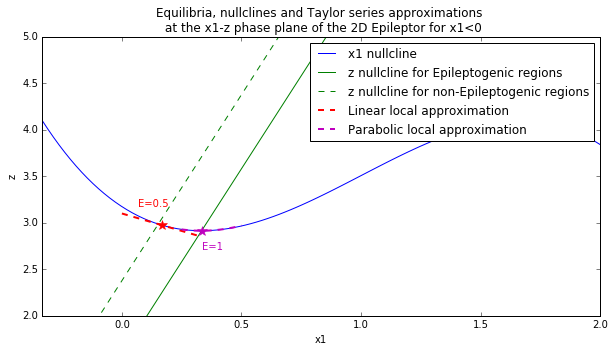

In [2]:
hide_me
import numpy as np
import matplotlib 
matplotlib.use('Qt5Agg')
import matplotlib.pyplot as mp

%matplotlib inline
# mp.ion()
# Fixed parameters for all regions:
y0 = 1.0
Iext1 = 3.1
x0cr = 857.0 / 1080  # Critical x0
r = 43.0 / 108  # Critical x0
x0ne = 0.5  # Default x0 for non epileptogenic regions
x0e = 1.0  # Default x0 for epileptogenic regions
x1lin0 = 1.0 / 6.0  # The point of the linear approximation (1st order Taylor expansion)
x1sq0 = 1.0 / 3.0  # The point of the square (parabolic) approximation (2nd order Taylor expansion)

# Lines:
x1 = np.expand_dims(np.linspace(-1.0 / 3.0, 6.0 / 3.0, 100), 1).T
# x1 nullcline:
zX1 = y0 + Iext1 - (x1 - 5.0 / 3.0) ** 3 - 2.0 * (x1 - 5.0 / 3.0) ** 2
# z nullcline:
zZe = 4.0 * (x1 - r * x0e + x0cr)  # for epileptogenic regions
zZne = 4.0 * (x1 - r * x0ne + x0cr)  # for non-epileptogenic regions
# approximations:
# linear:
x1lin = np.expand_dims(np.linspace(-0.0 / 3.0, 1.0 / 3.0, 30), 1).T
# x1 nullcline after linear approximation
zX1lin = y0 + Iext1 + 2.0 * x1lin0 ** 3 - 3.0 * x1lin0 ** 2 - 25.0 / 27.0 + \
         (-3.0 * x1lin0 ** 2 + 6.0 * x1lin0 - 5.0 / 3.0) * x1lin  # x1 nullcline after linear approximation
# center point without approximation:
zlin0 = y0 + Iext1 - (x1lin0 - 5.0 / 3.0) ** 3 - 2.0 * (x1lin0 - 5.0 / 3.0) ** 2
# square:
x1sq = np.expand_dims(np.linspace(1.5 / 6.0, 1.5 / 3.0, 30), 1).T
# x1 nullcline after parabolic approximation
zX1sq = + 2.0 * x1sq ** 2 - 4.0 * x1sq / 3.0 + y0 + Iext1 - 26.0 / 27.0
# center point (critical equilibrium point) without approximation:
zsq0 = y0 + Iext1 - (x1sq0 - 5.0 / 3.0) ** 3 - 2.0 * (x1sq0 - 5.0 / 3.0) ** 2

f, ax = mp.subplots(
    num='Equilibria, nullclines and Taylor series approximations \n at the x1-z phase plane of 2D Epileptor for x1<0',
    figsize=(10, 5))
ax.plot(x1[0, :], zX1[0, :], 'b-', label='x1 nullcline', linewidth=1)
ax.axes.hold(True)
ax.plot(x1[0, :], zZe[0, :], 'g-', label='z nullcline for Epileptogenic regions', linewidth=1)
ax.plot(x1[0, :], zZne[0, :], 'g--', label='z nullcline for non-Epileptogenic regions', linewidth=1)
ax.plot(x1lin[0, :], zX1lin[0, :], 'r--', label='Linear local approximation', linewidth=2)
ax.plot(x1sq[0, :], zX1sq[0, :], 'm--', label='Parabolic local approximation', linewidth=2)
ax.legend()
ax.plot(x1lin0, zlin0, '*', mfc='r', mec='r', ms=10)
ax.axes.text(x1lin0 - 0.1, zlin0 + 0.2, 'E=0.5', fontsize=10, color='r')
ax.plot(x1sq0, zsq0, '*', mfc='m', mec='m', ms=10)
ax.axes.text(x1sq0, zsq0 - 0.2, 'E=1', fontsize=10, color='m')
ax.set_title(
    'Equilibria, nullclines and Taylor series approximations \n at the x1-z phase plane of the 2D Epileptor for x1<0')
ax.axes.autoscale(tight=True)
ax.axes.set_xlabel('x1')
ax.axes.set_ylabel('z')
dum = ax.axes.set_ylim(2.0, 5.0)
mp.show()

# Demonstrating the Virtual Epileptic Patient TVB module


### Import TVB and VEP modules, set working, data and results' directories, select the appropriate reader, and initialize the logger:


In [3]:
hide_me
#import TVB and VEP module
import os
import sys

#BASEPATH = '/home/dionysios'
#TVB paths:
#TVBPATH = os.path.join(BASEPATH,'svn-tvb')
#sys.path.append(TVBPATH,'tvb_data','tvb_data') 
#sys.path.append(TVBPATH,''tvb_bin') 
#sys.path.append(TVBPATH,'scientific_library') 
#VEP path:
#sys.path.append(BASEPATH+'/svn-episense/research/Python') 
#print sys.path

#Set working and data directories:
from vep.base.constants import *

print 'Working directory:'
print FOLDER_VEP

print 'TVB data directory:'
print DATA_TVB

print 'Episense data directory:'
print DATA_EPISENSE

# Folder where logs will be written
from vep.base.utils import initialize_logger
logger = initialize_logger(__name__)

DATA_MODE = 'ep' #'TVB'

if DATA_MODE == 'ep':
    data_folder = os.path.join(DATA_EPISENSE, 'Head_TREC') #Head_TREC 'Head_JUNCH'
    from vep.episense.readers_episense import EpisenseReader
    reader = EpisenseReader()
else:
    data_folder = DATA_TVB
    from vep.tvb_api.readers_tvb import TVBReader
    reader = TVBReader()

logger.info("We will be reading from location " + data_folder)
print 'Selected data folder:'
print data_folder


Working directory:
/Users/dionperd/CBR/VEP
TVB data directory:
/Users/dionperd/CBR/svn/tvb/tvb-data/tvb-data
Episense data directory:
/Users/dionperd/CBR/svn/episense/demo-data
Selected data folder:
/Users/dionperd/CBR/svn/episense/demo-data/Head_TREC


### Read data and create a Head object:

In [4]:
hide_me
head = reader.read_head(data_folder)    
logger.debug("Loaded Head " + str(head))
logger.debug("Loaded Connectivity " + str(head.connectivity)) 
print "Loaded Head " + head.name
print "Loaded Connectivity summary: "
print head.connectivity.summary()
print "Loaded sensors "
sensors_list = list(head.sensorsSEEG.keys())
for s in sensors_list:
    print s.summary()

Loaded Head Head88
Loaded Connectivity summary: 
Connectivity{
a. centers=[
0.Unknown = [ -2.84669995 -10.69680023  22.15730095]
1.Brain-Stem = [ -3.52929997 -17.14609909  -4.16709995]
2.Left-Cerebellum-Cortex = [-26.05730057 -42.80379868  -0.81760001]
3.Left-Thalamus-Proper = [-11.94489956  -4.1704998   30.71389961]
4.Left-Caudate = [-13.10529995  17.62960052  33.33980179]
5.Left-Putamen = [-25.69829941  12.86069965  23.99090004]
6.Left-Pallidum = [-19.73489952  10.28170013  22.2052002 ]
7.Left-Hippocampus = [-23.94879913  -8.77089977  14.82409954]
8.Left-Amygdala = [-23.86339951   9.18910027   7.47599983]
9.Left-Accumbens-Area = [ -8.64509964  22.1303997   16.28750038]
10.ctx-lh-unknown = [ 0.  0.  0.]
11.ctx-lh-bankssts = [-48.97589874 -39.16400146  36.17850113]
12.ctx-lh-caudalanteriorcingulate = [ -2.22129989  20.82449913  49.99140167]
13.ctx-lh-caudalmiddlefrontal = [-33.27880096  16.92340088  66.05729675]
14.ctx-lh-cuneus = [ -3.38709998 -77.17500305  49.73379898]
15.ctx-lh-ento

### Create first an epileptogenicity hypothesis for this Head:

In [5]:
hide_me
from vep.base.hypothesis import Hypothesis, X0_DEF
# Create a new hypothesis for this Head:
hyp_ep = Hypothesis(head.number_of_regions, head.connectivity.weights, "EP Hypothesis")
hyp_ep.K = 0.1*hyp_ep.K
print 'Configure the hypothesis...'
print '...by defining the indices...'
print 'iE:'
iE = np.array([7, 50])
print iE
print '...the epileptogenicity values of the regions of interest...'
print 'E:'
E = np.array([0.5,0.8], dtype=np.float32)
print E
print '...as well as the regions of reference (e.g., the regions the seizure is starting from):'
seizure_indices = np.array([7, 50], dtype=np.int32)
print seizure_indices

hyp_ep.configure_e_hypothesis(iE, E, seizure_indices)
logger.debug(str(hyp_ep))
print 'Printing a summary of this hypothesis, together with the result of the Linear Stability Analysis:'
print hyp_ep


Configure the hypothesis...
...by defining the indices...
iE:
[ 7 50]
...the epileptogenicity values of the regions of interest...
E:
[ 0.5         0.80000001]
...as well as the regions of reference (e.g., the regions the seizure is starting from):
[ 7 50]
Printing a summary of this hypothesis, together with the result of the Linear Stability Analysis:
Hypothesis{
01.name = EP Hypothesis
02.K = 0.1
03.Iext1 = 3.1
04.seizure indices = [ 7 50]
05. no of seizure nodes = 2
06. x0=[
50. = 0.829335
7. = 0.54557
0. = 0.0
66. = 0.0
84. = 0.0
23. = 0.0
29. = 0.0
78. = 0.0
35. = 0.0
41. = 0.0
9. = -1.49705e-07
27. = -1.49705e-07
28. = -1.49705e-07
52. = -1.49705e-07
43. = -1.49705e-07
55. = -2.99409e-07
12. = -2.99409e-07
71. = -2.99409e-07
86. = -2.99409e-07
13. = -4.49114e-07
36. = -5.98819e-07
11. = -5.98819e-07
72. = -7.48523e-07
70. = -1.19764e-06
14. = -1.49705e-06
54. = -1.94616e-06
21. = -1.94616e-06
32. = -2.09587e-06
53. = -2.09587e-06
64. = -2.24557e-06
79. = -2.54498e-06
37. = -3.592

### Make another hypothesis by further specifying the first one, in terms, this time, of Excitability:

In [6]:
hide_me
# Create a new hypothesis for this Head:
#hyp_exc = Hypothesis(head.number_of_regions, head.connectivity.weights, "Excitability Hypothesis")
import copy as cp
hyp_exc = cp.deepcopy(hyp_ep)
print 'Configure the hypothesis...'
print '...by defining the indices of all regions assumed to neither generate nor propagate the seizure...'
ii = np.array(range(head.number_of_regions), dtype=np.int32)
ix0 = np.delete(ii, iE)
print 'ix0:'
print ix0
print '...and setting their excitability values x0 equal to the default "healthy" one:'
print 'x0:' 
print X0_DEF

hyp_exc.configure_x0_hypothesis(ix0, X0_DEF, seizure_indices)
logger.debug(str(hyp_exc))
print 'Printing a summary of this hypothesis, together with the result of the Linear Stability Analysis:'
print hyp_exc


Configure the hypothesis...
...by defining the indices of all regions assumed to neither generate nor propagate the seizure...
ix0:
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 51
 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76
 77 78 79 80 81 82 83 84 85 86 87]
...and setting their excitability values x0 equal to the default "healthy" one:
x0:
0.0
Printing a summary of this hypothesis, together with the result of the Linear Stability Analysis:
Hypothesis{
01.name = EP Hypothesis
02.K = 0.1
03.Iext1 = 3.1
04.seizure indices = [ 7 50]
05. no of seizure nodes = 2
06. x0=[
50. = 0.829482
7. = 0.545753
68. = -0.0558632
46. = -0.0558728
25. = -0.0558879
3. = -0.0559
58. = -0.0559024
16. = -0.0559113
59. = -0.0559132
62. = -0.0559291
77. = -0.0559301
61. = -0.055931
15. = -0.0559318
49. = -0.0559325
1. = -0.0559342
76. = -0.0559379
48. = -0.0559381
18. = -0.0559

### Configure simulation

In [7]:
hide_me

print "Getting SEEG sensors and projections from head"
sensorsSEEG=[]
projections=[]    
for sensors, projection in head.sensorsSEEG.iteritems():
    if projection is None:
        continue
    else:
        sensorsSEEG.append(sensors)
        projections.append(projection) 
        
print 'Select TVB or Episense simulator and the desired Epileptor model, as well as set simulations settings'
SIMULATION_MODE ='tvb' #'ep'
print 'Selected simulator: '+SIMULATION_MODE

#    if SIMULATION_MODE == 'ep':
#        from vep.episense.simulator_episense import SimulatorEpisense
#        simulator_instance = SimulatorEpisense(data_folder)
#    else:
MODEL = '11v' #'6v','2v','11v','tvb'
print 'Selected model: '+MODEL

#Monitor adjusted to the model    
nvar = {'tvb':6,
        '6v':6,
        '2v':2,
        '11v':11}
monitor_expr = {'tvb':['x2 - x1','x1', 'y1', 'z', 'x2', 'y2', 'g' ],
                '6v':["y3 - y0","y0", "y1", "y2", "y3", "y4", "y5"],
                '2v':["y0", "y1"],
                '11v':["y3 - y0","y0", "y1", "y2", "y3", "y4", "y5", "y6", "y7", "y8", "y9", "y10"]}          
#print "Expressions monitored: "
#for expr in monitor_expr[MODEL]:
#    print expr

#Time scales:    
fs = 2*1024.0
dt = 1000.0/fs
print "Integration (sampling) frequency: "+str(fs)
print "...and time step: "+ str(dt) 
fsAVG = 512.0 #fs/10
fsSEEG = fsAVG
print "Monitor (moving average) frequency: "+str(fsAVG)
print "...SEEG frequency: "+ str(fsSEEG) 



Getting SEEG sensors and projections from head
Select TVB or Episense simulator and the desired Epileptor model, as well as set simulations settings
Selected simulator: tvb
Selected model: 11v
Integration (sampling) frequency: 2048.0
...and time step: 0.48828125
Monitor (moving average) frequency: 512.0
...SEEG frequency: 512.0


In [8]:
hide_me
#Noise configuration
from tvb.simulator import noise
#                                  x1  y1   z     x2   y2   g 
noise_intensity = {'tvb':np.array([0., 0., 5e-8, 0.0, 5e-8, 0.]),
                    '6v':np.array([ 0., 0., 5e-8, 0.0, 5e-8, 0.]),
                    '2v':np.array([ 0.,     5e-8]) ,
                    '11v':np.array([0., 0., 1e-5, 0.0, 1e-5, 0., 
#                                   #x0   slope Iext1 Iext2 K 
                                    1e-7, 1e-2, 1e-7, 1e-2, 1e-8])} 
#Preconfigured noise                                     
from tvb.datatypes import equations
eq=equations.Linear(parameters={"a": 0.0, "b": 1.0}) #default = a*y+b
noise=noise.Multiplicative(nsig=noise_intensity[MODEL], b=eq,
                           random_stream=np.random.RandomState(seed=NOISE_SEED)) #define ntau for colored noise: ntau = 10, 
noise_shape = noise.nsig.shape                    
#Colored noise:                
#noise.configure_coloured(dt=dt,shape=noise_shape)
#White noise:               
noise.configure_white(dt=dt)
#Get sensors and projections:
print "Summary of noise settings: "
print noise
     

/Users/dionperd/anaconda/anaconda/envs/python2_7/lib/python2.7/site-packages/sqlalchemy/ext/declarative/api.py:173: SAWarning: Unmanaged access of declarative attribute fk_algorithm from non-mapped class WorkflowStepView
  (desc.fget.__name__, cls.__name__))
/Users/dionperd/anaconda/anaconda/envs/python2_7/lib/python2.7/site-packages/sqlalchemy/ext/declarative/api.py:173: SAWarning: Unmanaged access of declarative attribute fk_workflow from non-mapped class WorkflowStepView
  (desc.fget.__name__, cls.__name__))
/Users/dionperd/anaconda/anaconda/envs/python2_7/lib/python2.7/site-packages/sqlalchemy/ext/declarative/api.py:173: SAWarning: Unmanaged access of declarative attribute fk_algorithm from non-mapped class WorkflowStep
  (desc.fget.__name__, cls.__name__))
/Users/dionperd/anaconda/anaconda/envs/python2_7/lib/python2.7/site-packages/sqlalchemy/ext/declarative/api.py:173: SAWarning: Unmanaged access of declarative attribute fk_workflow from non-mapped class WorkflowStep
  (desc.fget

Summary of noise settings: 
Multiplicative(dt=0.488281, ntau=0)


In [9]:
hide_me
from vep.tvb_api.simulator_tvb import SimulationSettings

settings = SimulationSettings(length=10000,integration_step=dt, monitor_sampling_period=fs/fsSEEG*dt,
                              noise_preconfig=noise, monitor_expr=monitor_expr[MODEL]) #noise_intensity=noise_intensity, 
#print "Summary of simulation settings: "
#print settings

#Build the model
from vep.tvb_api.simulator_tvb import *
build_model = {'tvb':build_tvb_model,
                '6v':build_ep_6sv_model,
                '2v':build_ep_2sv_model,
                '11v':build_ep_11sv_model}
prepare_model = {'tvb':prepare_for_tvb_model,
                 '6v':prepare_for_6sv_model,
                 '2v':prepare_for_2sv_model,
                 '11v':prepare_for_11sv_model}        
# Choosing the model:           epileptor model,      history
simulator_instance = SimulatorTVB(build_model[MODEL], prepare_model[MODEL])
print "Simulator instance: "
print settings  

#Prepare output
save_dict = dict()
seeg=dict()
x1=dict()
z=dict()
if MODEL!='2v':
    lfp=dict()
    y1=dict()
    x2=dict()
    y2=dict()
    g=dict()
    hpf=dict()   

    if MODEL=='11v':       
        x0ts=dict()
        slopeTS=dict()
        Iext1ts=dict()
        Iext2ts=dict()
        Kts=dict()


/Users/dionperd/anaconda/anaconda/envs/python2_7/lib/python2.7/site-packages/sqlalchemy/ext/declarative/api.py:173: SAWarning: Unmanaged access of declarative attribute __tablename__ from non-mapped class Volume
  (desc.fget.__name__, cls.__name__))
/Users/dionperd/anaconda/anaconda/envs/python2_7/lib/python2.7/site-packages/sqlalchemy/ext/declarative/api.py:173: SAWarning: Unmanaged access of declarative attribute __tablename__ from non-mapped class Connectivity
  (desc.fget.__name__, cls.__name__))
/Users/dionperd/anaconda/anaconda/envs/python2_7/lib/python2.7/site-packages/sqlalchemy/ext/declarative/api.py:173: SAWarning: Unmanaged access of declarative attribute __tablename__ from non-mapped class SensorsData
  (desc.fget.__name__, cls.__name__))
/Users/dionperd/anaconda/anaconda/envs/python2_7/lib/python2.7/site-packages/sqlalchemy/orm/mapper.py:984: SAWarning: Reassigning polymorphic association for identity 'EEG' from <Mapper at 0x1261df550; SensorsEEGData> to <Mapper at 0x12642

Simulator instance: 
SimulationSettings{
a. integration_step = 0.48828125
b. monitor_sampling_period = 1.953125
c. monitor_expr = ['y3 - y0', 'y0', 'y1', 'y2', 'y3', 'y4', 'y5', 'y6', 'y7', 'y8', 'y9', 'y10']
d. simulated_period = 10000
e. noise_intensity = 0.0001
f. integration_noise_seed = 42}


/Users/dionperd/anaconda/anaconda/envs/python2_7/lib/python2.7/site-packages/sqlalchemy/ext/declarative/api.py:173: SAWarning: Unmanaged access of declarative attribute __tablename__ from non-mapped class SpatialPattern
  (desc.fget.__name__, cls.__name__))
/Users/dionperd/anaconda/anaconda/envs/python2_7/lib/python2.7/site-packages/sqlalchemy/ext/declarative/api.py:173: SAWarning: Unmanaged access of declarative attribute __tablename__ from non-mapped class SpatioTemporalPattern
  (desc.fget.__name__, cls.__name__))
/Users/dionperd/anaconda/anaconda/envs/python2_7/lib/python2.7/site-packages/sqlalchemy/ext/declarative/api.py:173: SAWarning: Unmanaged access of declarative attribute __tablename__ from non-mapped class StimuliRegion
  (desc.fget.__name__, cls.__name__))
/Users/dionperd/anaconda/anaconda/envs/python2_7/lib/python2.7/site-packages/sqlalchemy/ext/declarative/api.py:173: SAWarning: Unmanaged access of declarative attribute __tablename__ from non-mapped class StimuliSurface


### Simulate the two hypotheses:

In [10]:
hide_me
from scipy.io import savemat
from vep.base.utils import filter_data

hyps = {'ep':hyp_ep,'exc':hyp_exc}

for hyp in ('ep','exc'):
    
    print "Configuring simulation for hypothesis "+hyps[hyp].name
    sim= simulator_instance.config_simulation(hyps[hyp], head, settings)
    print "Summary of simulation configuration: "
    print sim
    print "Further specifying parameters of the model"
    if MODEL=='tvb':
            sim.model.tt = 0.25*sim.model.tt
            sim.model.r = 0.001
    else:
        #sim.model.zmode = np.array("sig")
        sim.model.tau0 = 10000.0
        sim.model.tau1 = 0.25*sim.model.tau1
        if MODEL=='11v':    
            sim.model.pmode=np.array("z") #"z","g","z*g", default="const"
            sim.model.slope = 0.25
            
    print "Integration..."        
    ttavg, tavg_data = simulator_instance.launch_simulation(sim,hyps[hyp])
    print "Simulated signal return shape: " + str(tavg_data.shape)
    print "Time: " + str(ttavg[0]) + " - " + str(ttavg[-1])
    print "Values: " + str(tavg_data.min()) + " - " + str(tavg_data.max())
    print "Simulated signal return shape: " + str(tavg_data.shape)
    print "Time: " + str(ttavg[0]) + " - " + str(ttavg[-1])
    print "Values: " + str(tavg_data.min()) + " - " + str(tavg_data.max())

    print "Unpacking state variables, calculating observables (lfp, hpf, seeg) and saving results..."        
    #Unpacking state variables, calculating observables (lfp, hpf, seeg) and saving results...
    #Time:
    ttavg = np.array(ttavg,dtype='float32')

    if MODEL=='2v':
        x1[hyp] = np.array(tavg_data[:, 0, :, 0],dtype='float32')
        z[hyp] = np.array(tavg_data[:, 1, :, 0],dtype='float32')
        save_dict = {'x1':x1[hyp],'z':z[hyp],'time_in_ms':ttavg}

        seeg[hyp]=[]                    
        for i in range(len(projections)):
            seeg_i = np.dot(x1[hyp],projections[i].T)
            seeg.append(seeg_i)
            save_dict['seeg'+str(i)]=seeg_i
        savemat(os.path.join(FOLDER_RES, hyps[hyp].name+"_ts.mat"),save_dict) 
        del save_dict
        #del tavg_data

    else:
        lfp[hyp] = np.array(tavg_data[:, 0, :, 0],dtype='float32')
        z[hyp] = np.array(tavg_data[:, 3, :, 0],dtype='float32')
        x1[hyp] = np.array(tavg_data[:, 1, :, 0],dtype='float32')
        y1[hyp] = np.array(tavg_data[:, 2, :, 0],dtype='float32')
        x2[hyp] = np.array(tavg_data[:, 4, :, 0],dtype='float32')
        y2[hyp] = np.array(tavg_data[:, 5, :, 0],dtype='float32')
        g[hyp] = np.array(tavg_data[:, 6, :, 0],dtype='float32')
        hpf[hyp] = np.empty((ttavg.size,hyps[hyp].n_regions)).astype(np.float32)
        for i in range(hyps[hyp].n_regions):
            hpf[hyp][:,i] = filter_data(lfp[hyp][:,i], 10, 250, fsAVG)#.astype(np.float32) #.transpose()
        hpf[hyp]=np.array(hpf[hyp],dtype='float32')   
        hpf[hyp] = filter_data(lfp[hyp], fsAVG/30, fsAVG/3, fsAVG)
        save_dict = {'lfp':lfp[hyp],'hpf':hpf[hyp],'x1':x1[hyp],'y1':y1[hyp],'z':z[hyp],
                     'x2':x2[hyp],'y2':y2[hyp],'g':g[hyp],'time_in_ms':ttavg}

        seeg[hyp]=[]                    
        for i in range(len(projections)):
            seeg_i = np.dot(hpf[hyp],projections[i].T)
            seeg[hyp].append(seeg_i)
            save_dict['seeg'+str(i)]=seeg_i

        if MODEL=='11v':       
            x0ts[hyp]=np.array(tavg_data[:, 7, :, 0],dtype='float32')
            slopeTS[hyp]=np.array(tavg_data[:, 8, :, 0],dtype='float32')
            Iext1ts[hyp]=np.array(tavg_data[:, 9, :, 0],dtype='float32')
            Iext2ts[hyp]=np.array(tavg_data[:, 10, :, 0],dtype='float32')
            Kts[hyp]=np.array(tavg_data[:, 11, :, 0],dtype='float32')
            save_dict['x0']=x0ts[hyp]
            save_dict['slope']=slopeTS[hyp]
            save_dict['Iext1']=Iext1ts[hyp]
            save_dict['Iext2']=Iext2ts[hyp]
            save_dict['K']=Kts[hyp]

    savemat(os.path.join(FOLDER_RES, hyps[hyp].name+"_ts.mat"),save_dict)  
    del save_dict
    #del tavg_data

Configuring simulation for hypothesis EP Hypothesis
Summary of simulation configuration: 
Simulator(bound=False, value=None)
Further specifying parameters of the model
Integration...
Simulated signal return shape: (5120, 12, 88, 1)
Time: 79.1015625 - 10077.1484375
Values: -17.70168513 - 4.85318698862
Simulated signal return shape: (5120, 12, 88, 1)
Time: 79.1015625 - 10077.1484375
Values: -17.70168513 - 4.85318698862
Unpacking state variables, calculating observables (lfp, hpf, seeg) and saving results...
Configuring simulation for hypothesis EP Hypothesis
Summary of simulation configuration: 
Simulator(bound=False, value=None)
Further specifying parameters of the model
Integration...
Simulated signal return shape: (5120, 12, 88, 1)
Time: 79.1015625 - 10077.1484375
Values: -18.6175572346 - 4.84724335597
Simulated signal return shape: (5120, 12, 88, 1)
Time: 79.1015625 - 10077.1484375
Values: -18.6175572346 - 4.84724335597
Unpacking state variables, calculating observables (lfp, hpf, se

### Plot everything:

Plotting the Head connectivity and statistics


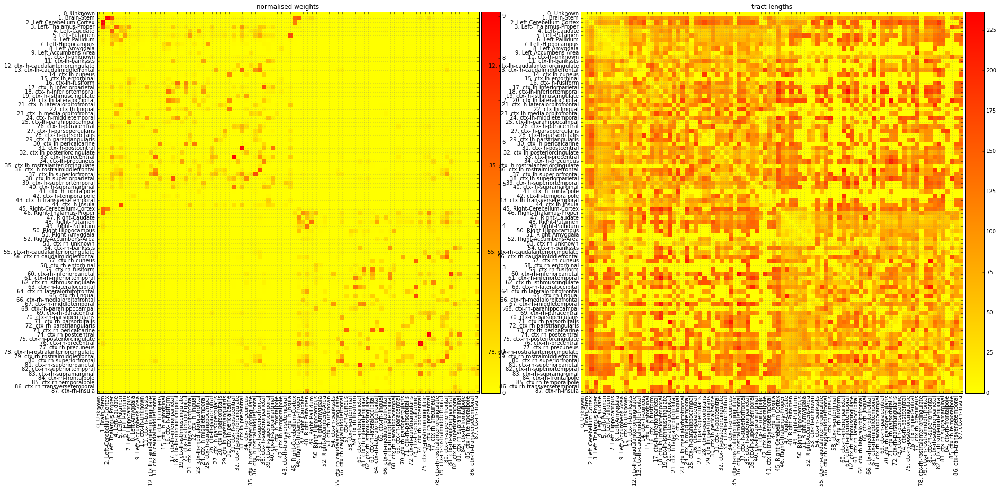

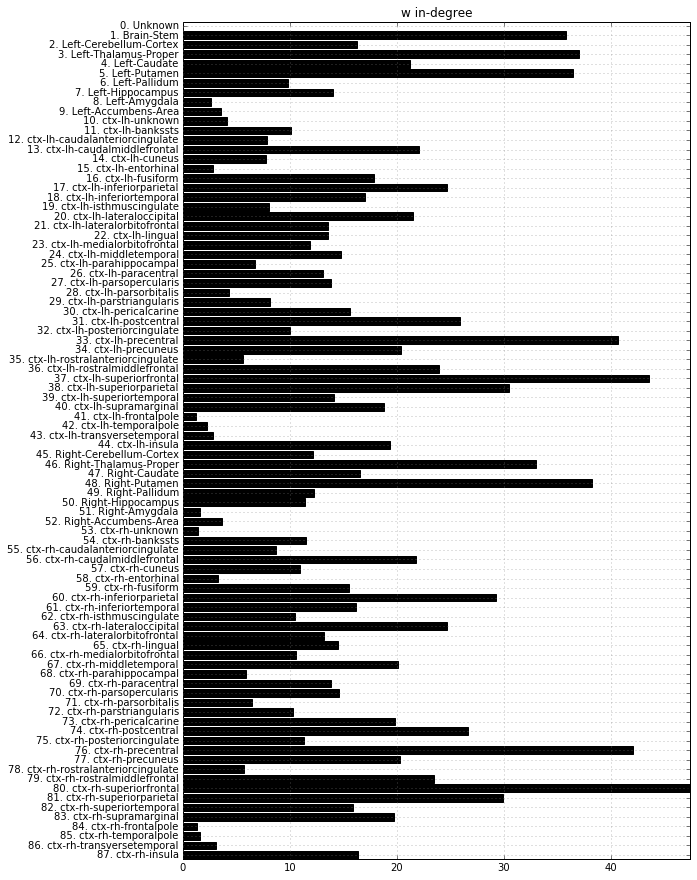

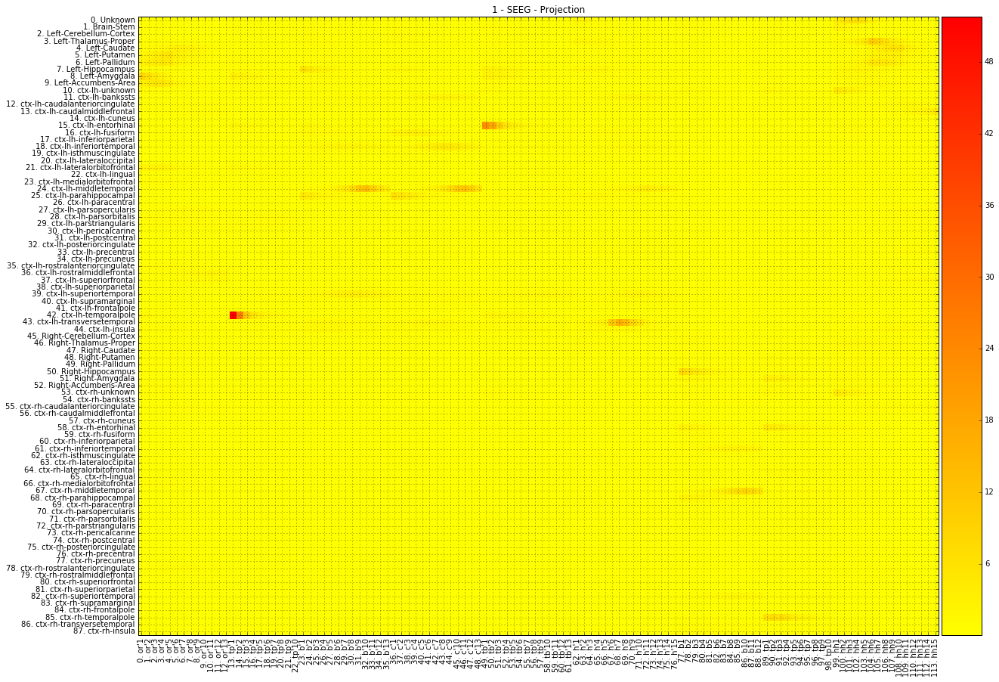

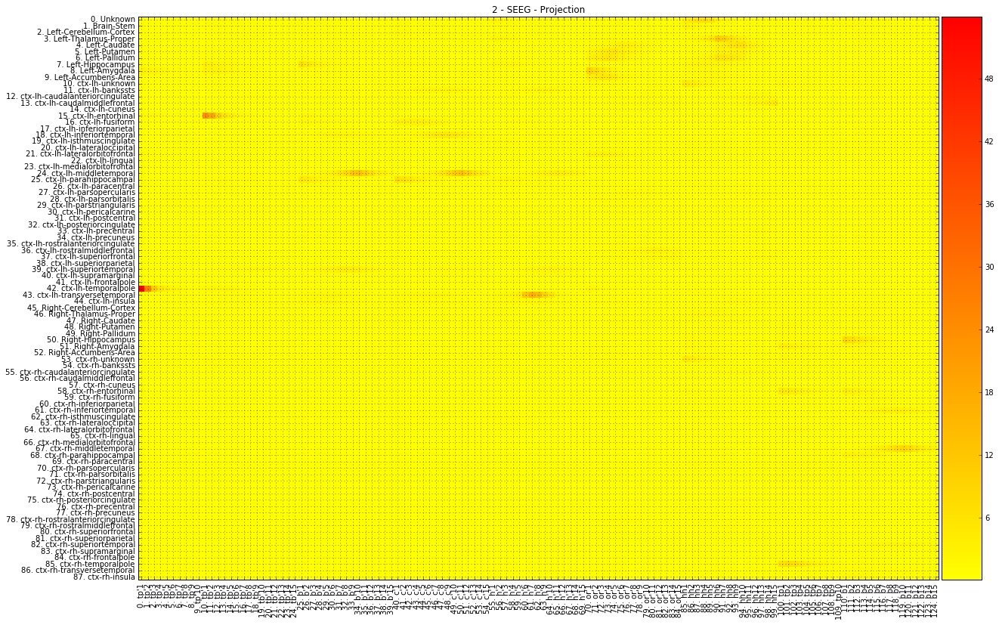

Plotting the epileptogenicity hypothesis EP Hypothesis


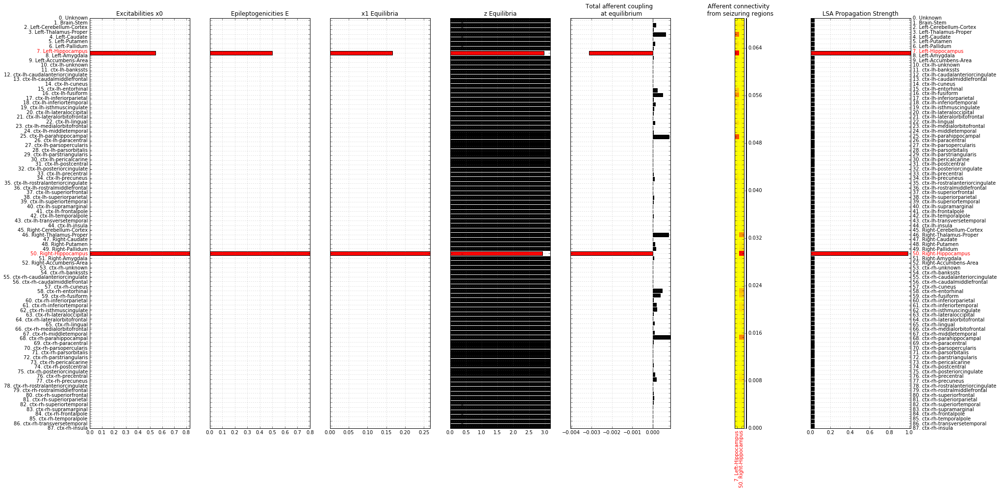

vep/base/plot_tools.py:275: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.
  if special_idx!=None:
vep/base/plot_tools.py:282: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.
  if special_idx!=None:


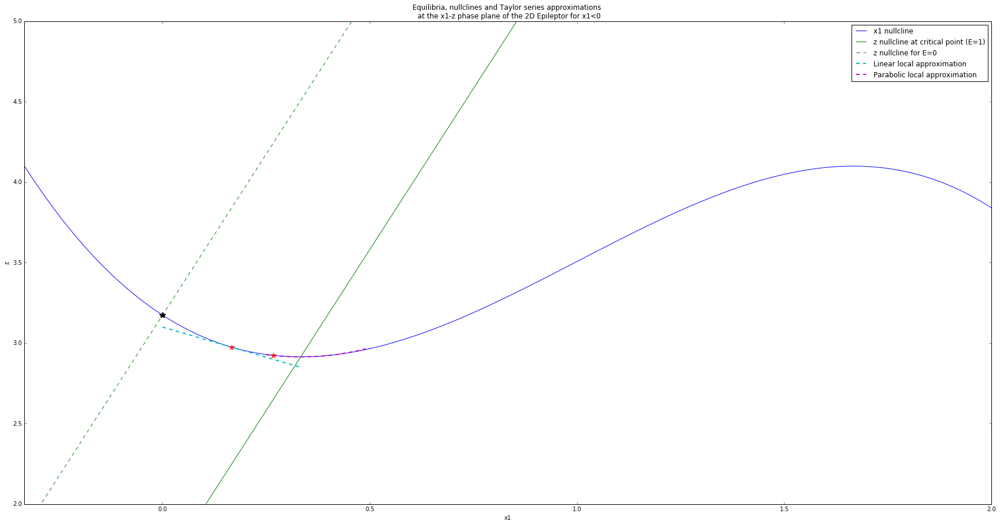

...and the respective simulated time series and trajectories:


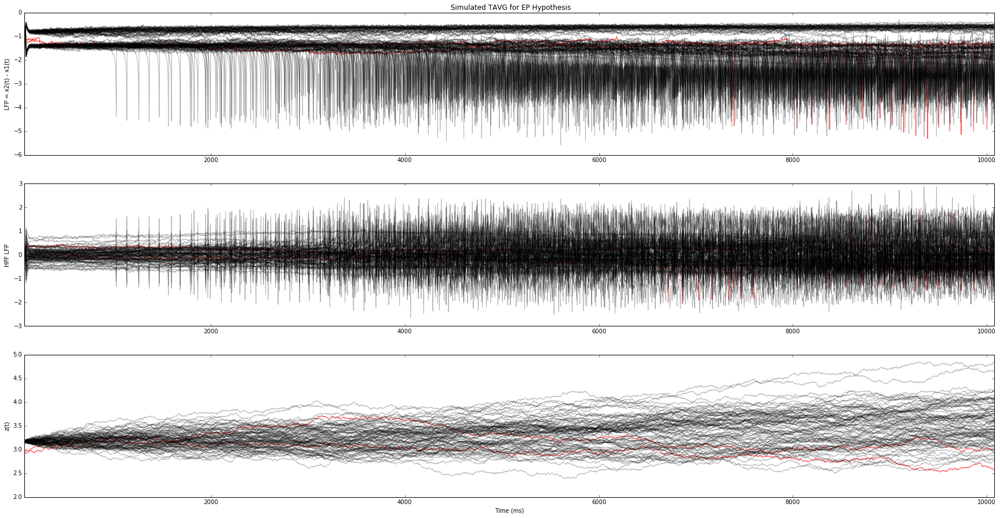

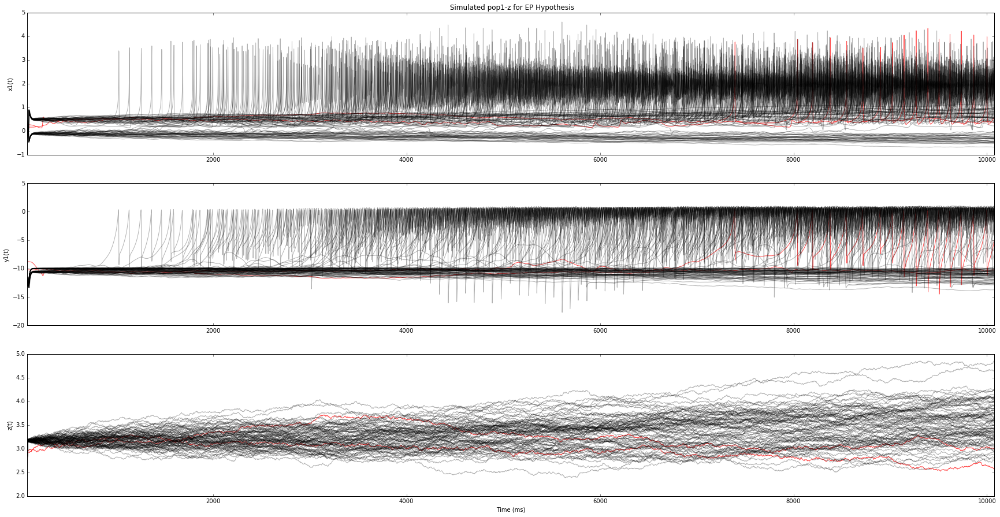

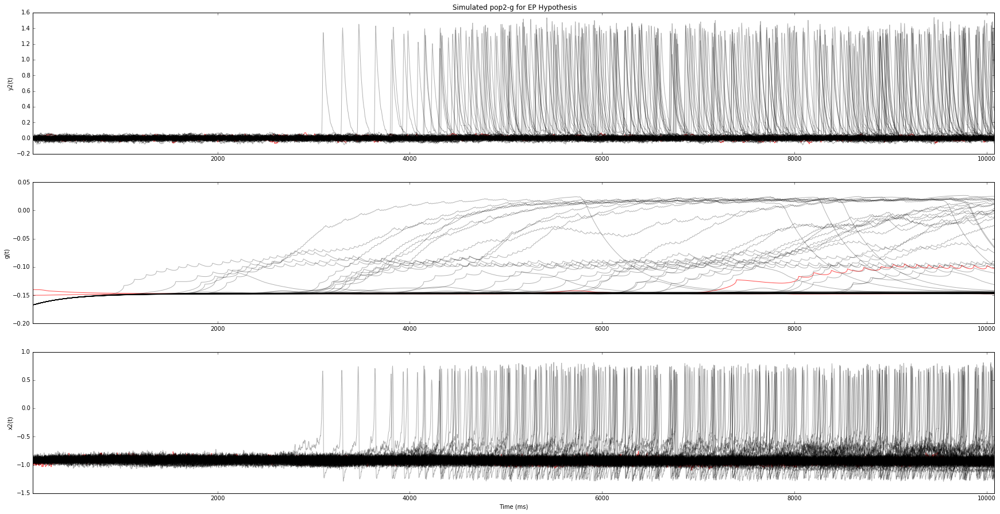

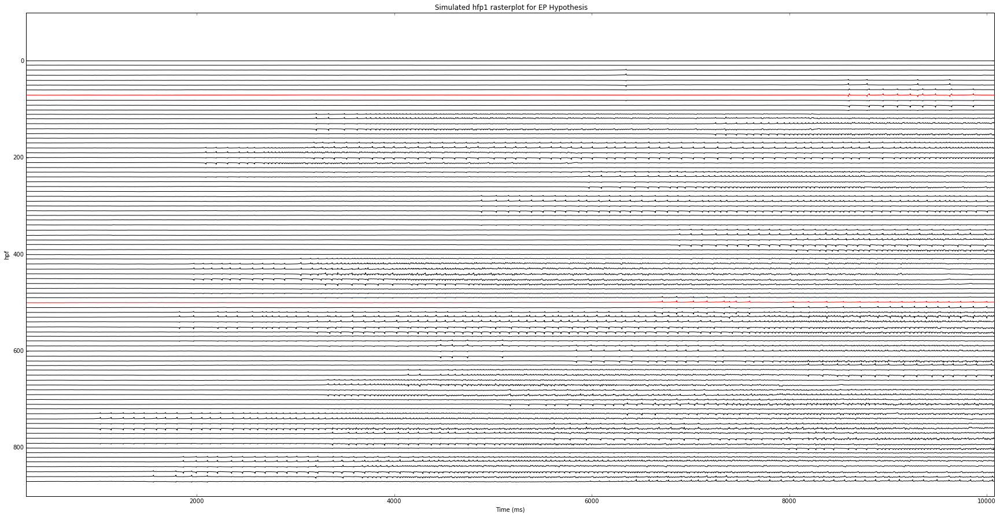

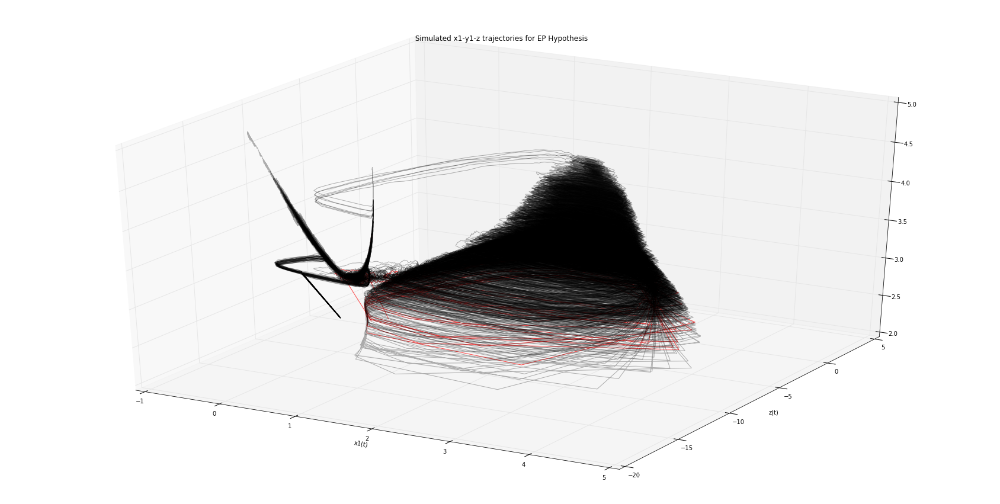

...

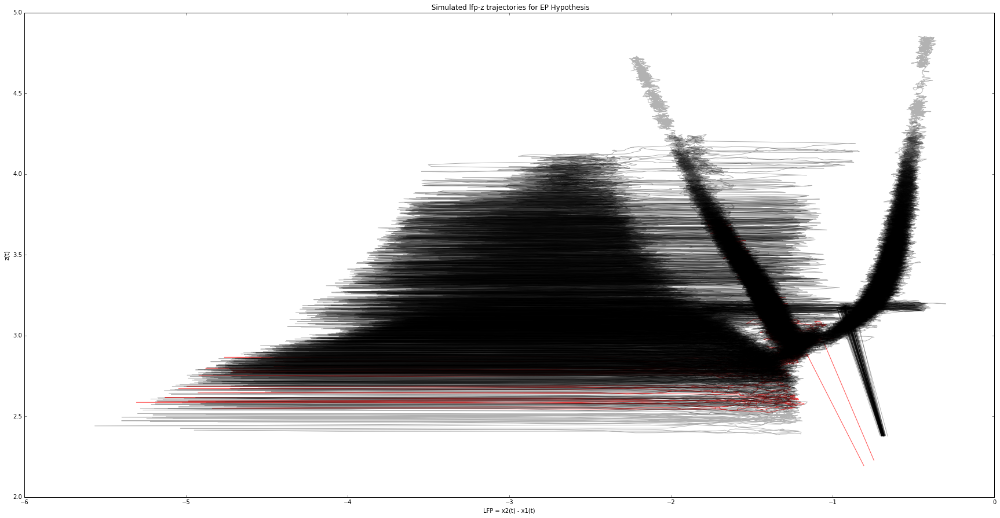

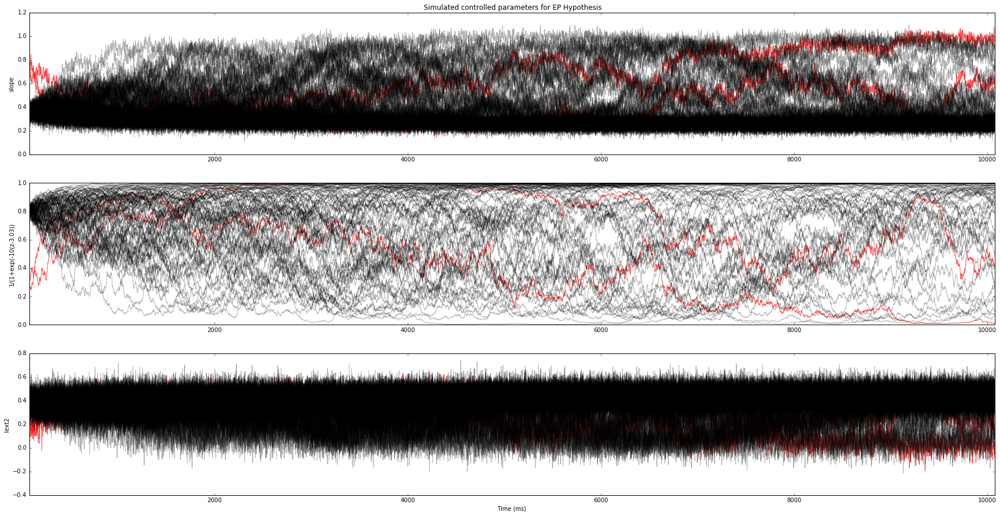

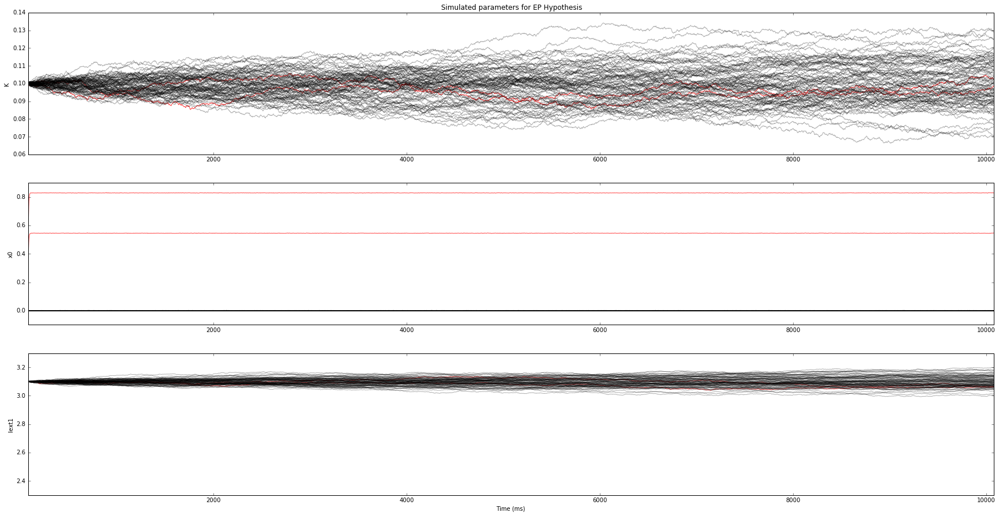

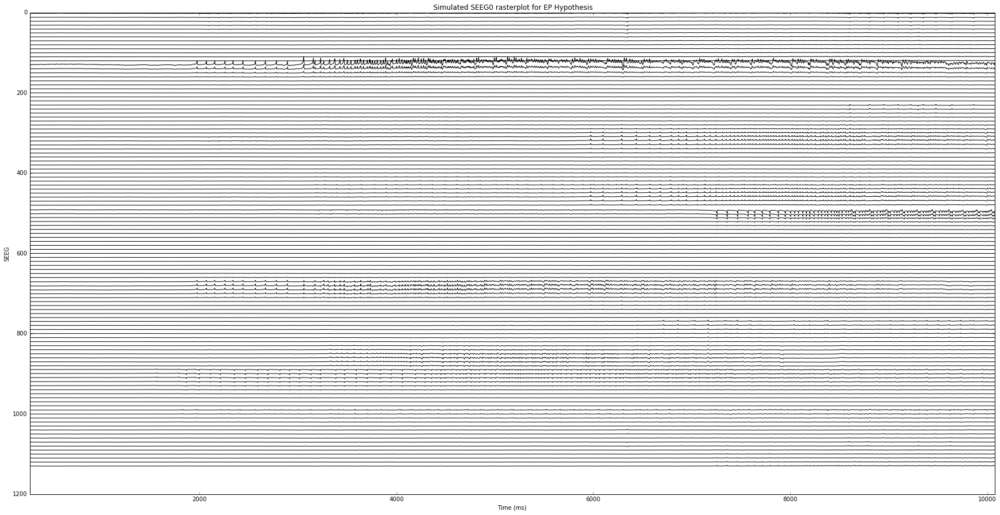

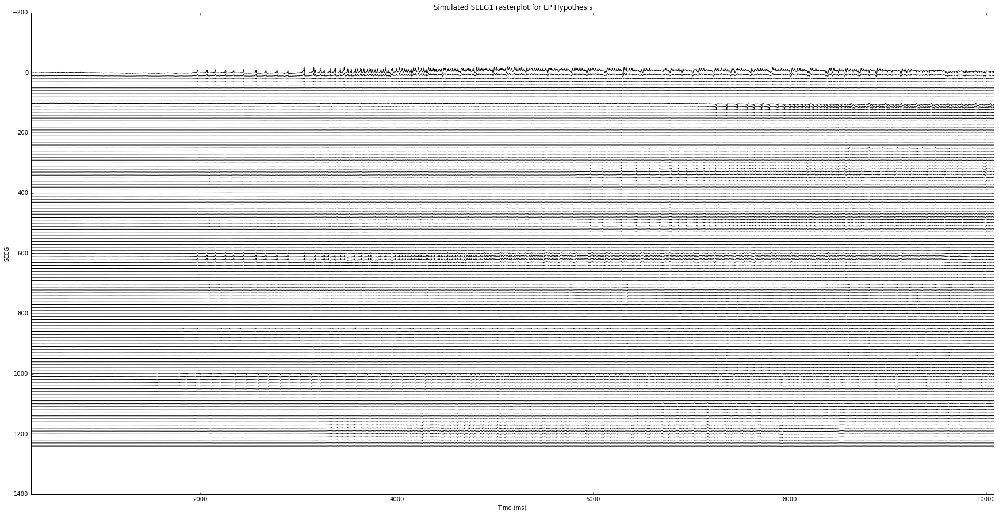

Plotting the epileptogenicity hypothesis EP Hypothesis


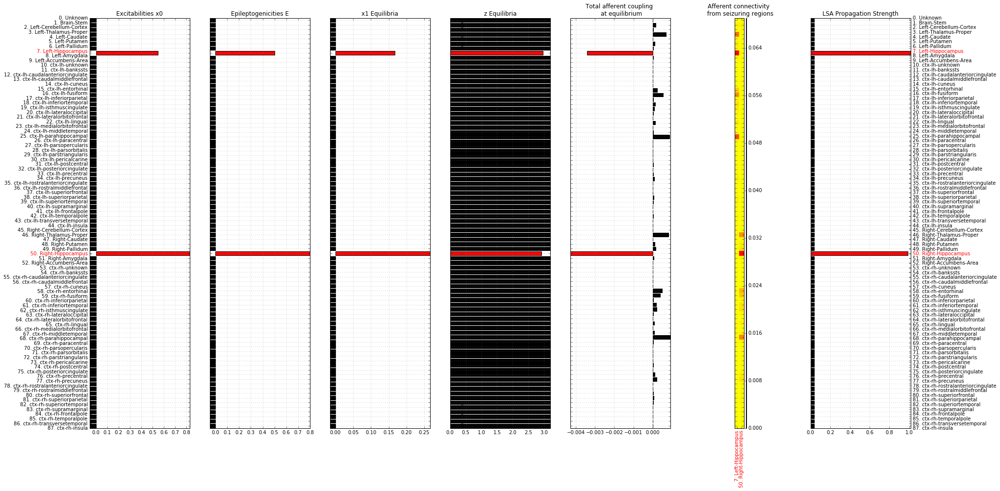

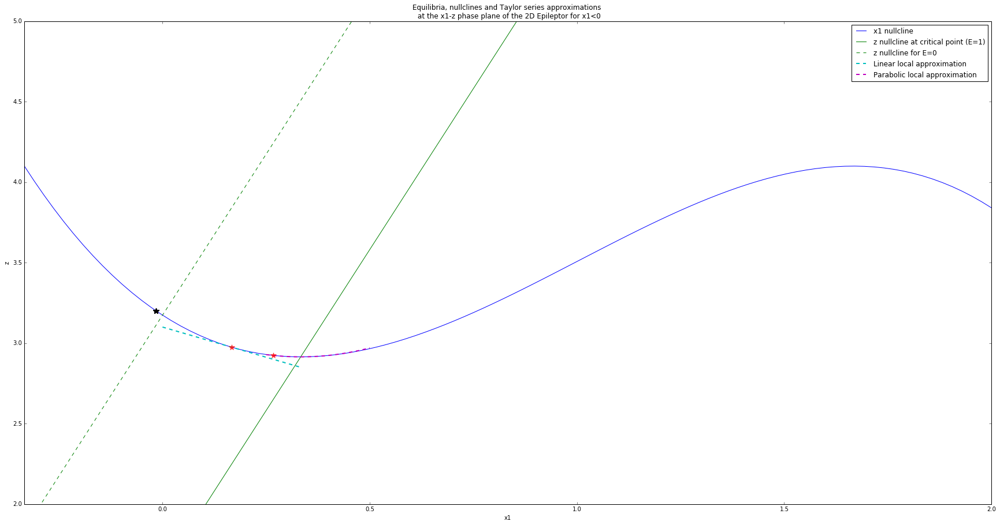

...and the respective simulated time series and trajectories:


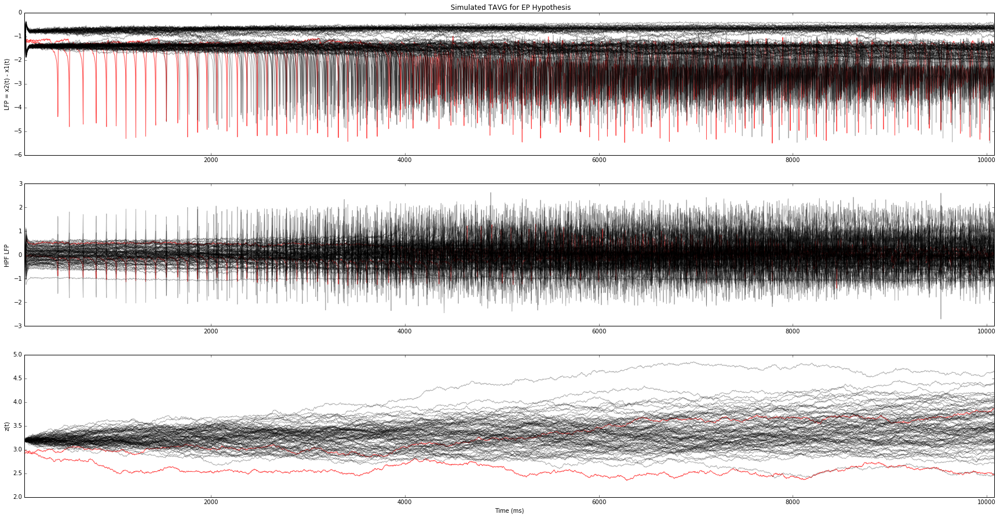

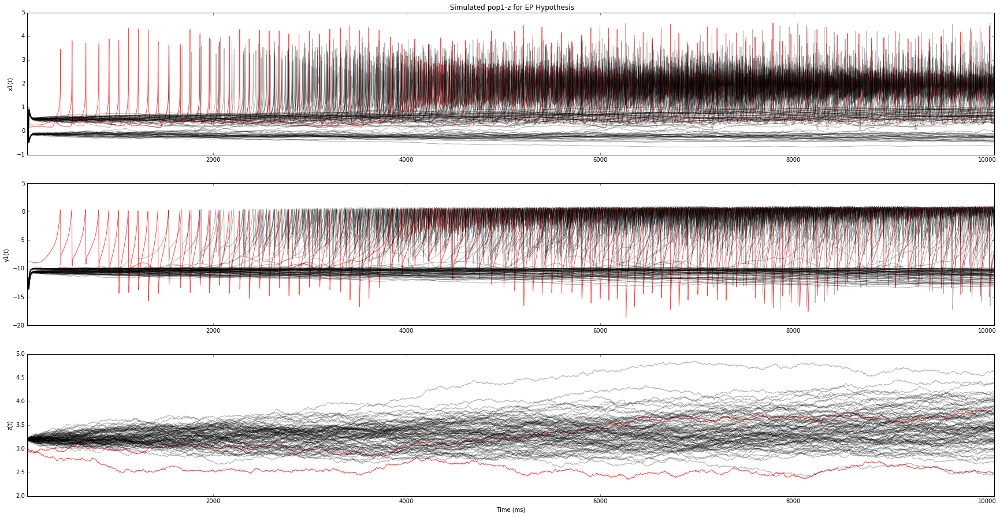

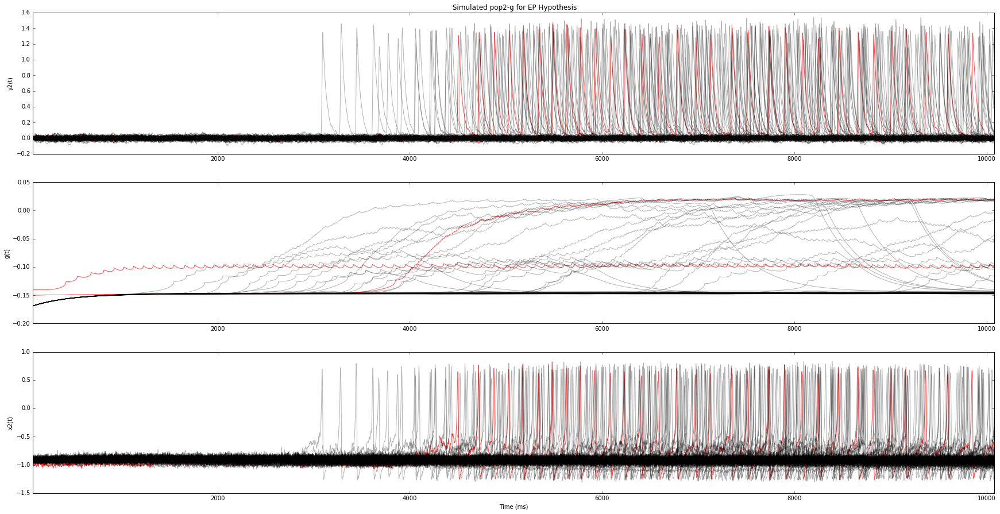

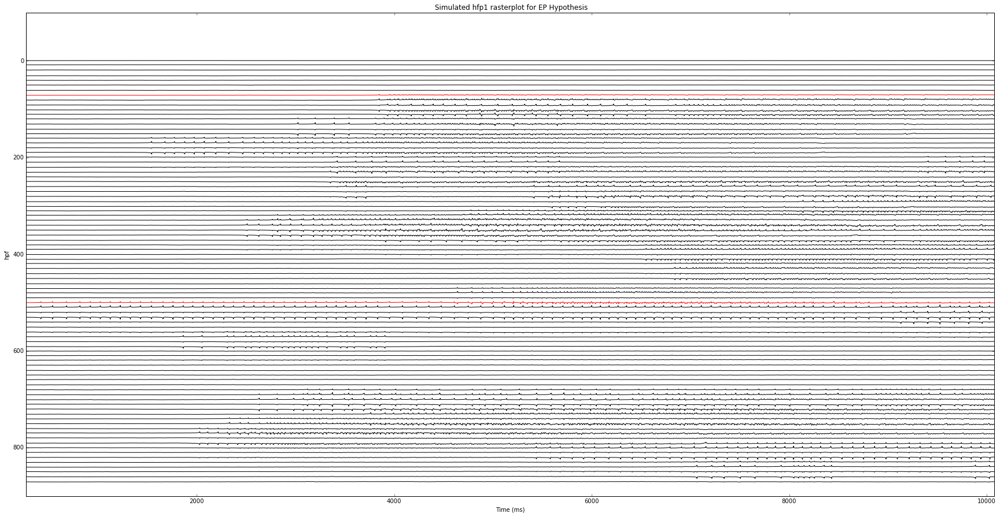

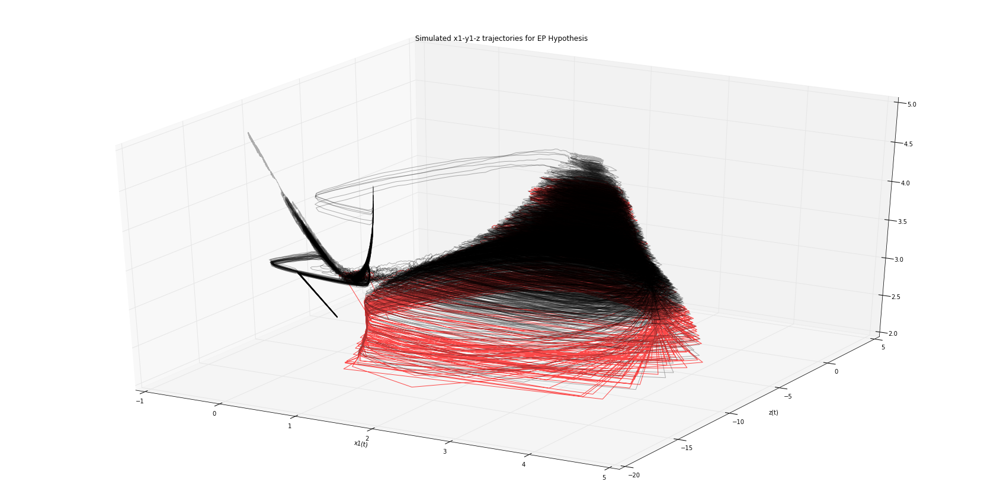

...

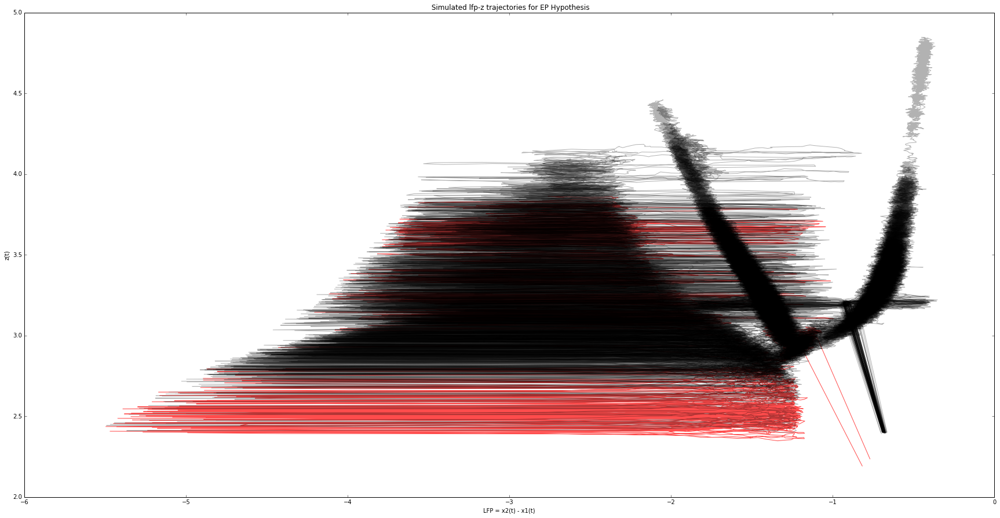

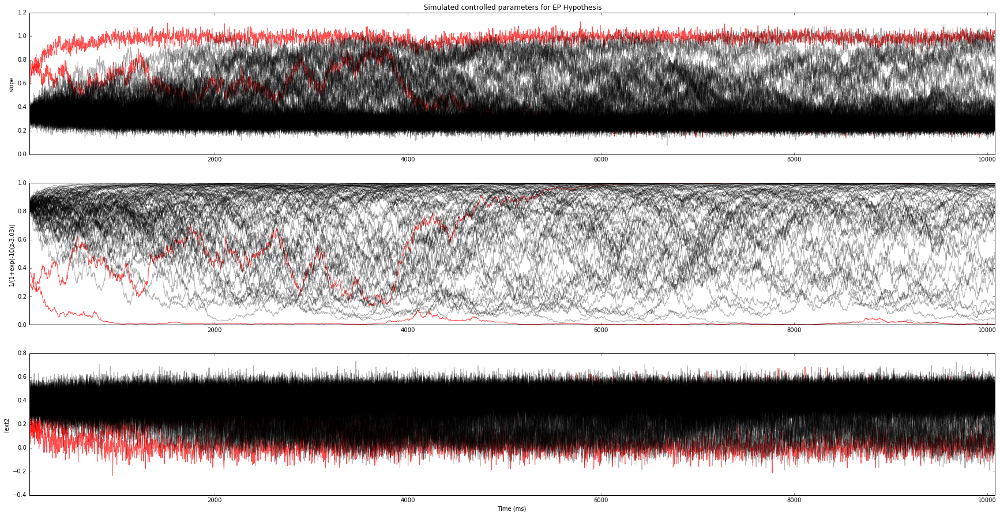

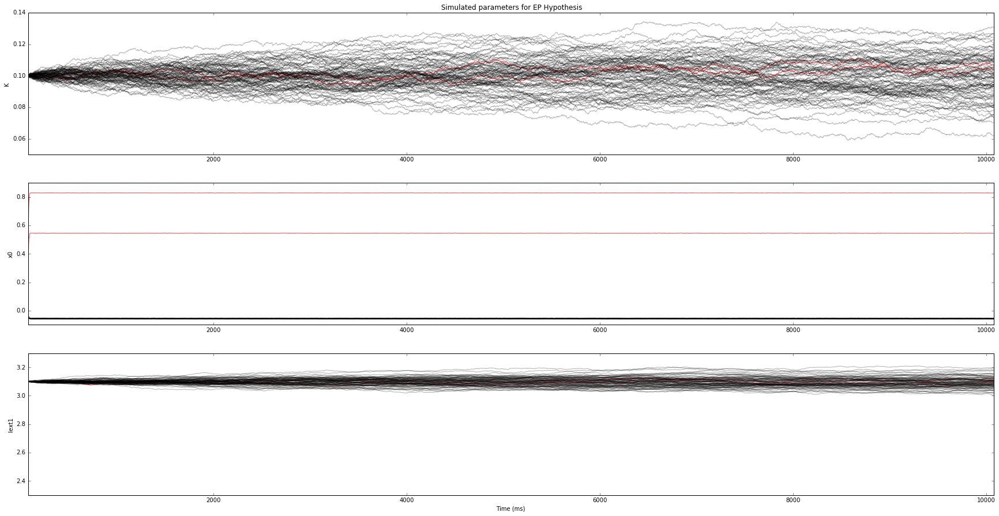

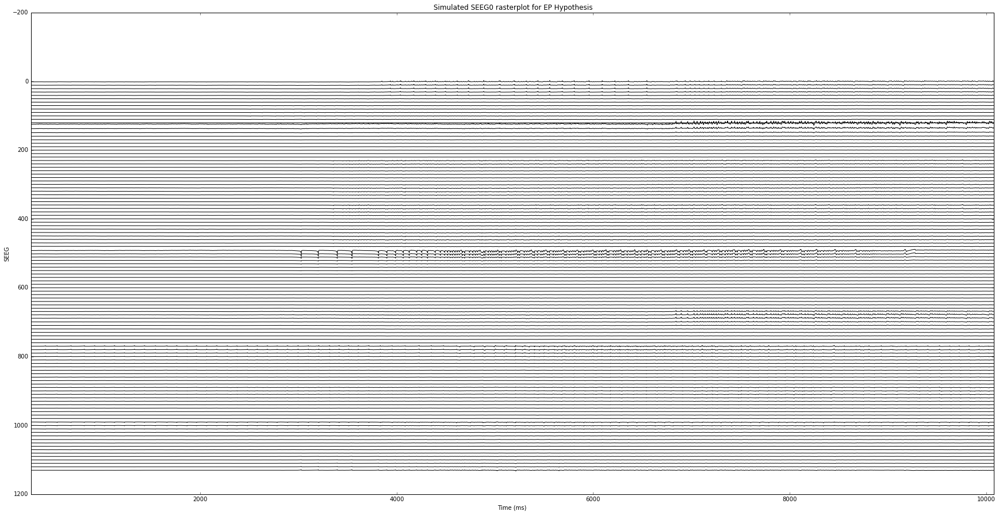

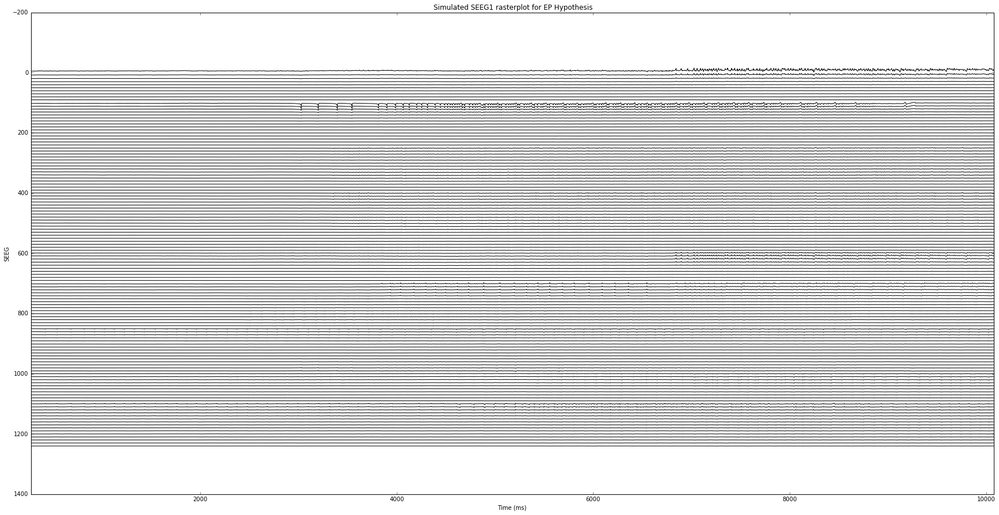

In [11]:
hide_me
from vep.base.plot_tools import plot_head, plot_hypothesis, plot_timeseries, plot_raster, plot_trajectories
# Figures related settings:
VERY_LARGE_SIZE = (30, 15)
LARGE_SIZE = (20, 15)
SMALL_SIZE = (15, 10)
FOLDER_FIGURES = os.path.join(FOLDER_VEP, 'figures')
FIG_FORMAT = 'eps'
SAVE_FLAG = True
SHOW_FLAG = True

print 'Plotting the Head connectivity and statistics'
plot_head(head, save_flag=SAVE_FLAG, show_flag=SHOW_FLAG, 
              figure_dir=FOLDER_FIGURES, figsize=VERY_LARGE_SIZE)

for hyp in ('ep','exc'):

    print 'Plotting the epileptogenicity hypothesis '+hyps[hyp].name
    plot_hypothesis(hyps[hyp], head.connectivity.region_labels,
                        save_flag=SAVE_FLAG, show_flag=SHOW_FLAG, 
                        figure_dir=FOLDER_FIGURES, figsize=VERY_LARGE_SIZE)

    print '...and the respective simulated time series and trajectories:'
    #Plotting
    if MODEL=='2v':
        plot_timeseries(ttavg, {'x1(t)': x1[hyp], 'z(t)': z[hyp]},
                        seizure_indices, title=" Simulated time series for " + hyps[hyp].name,
                        save_flag=SAVE_FLAG, show_flag=SHOW_FLAG, figure_dir=FOLDER_FIGURES, 
                        labels = head.connectivity.region_labels, figsize=VERY_LARGE_SIZE)
        plot_trajectories({'x1(t)': x1[hyp], 'z(t)': z[hyp]},
                        seizure_indices, title=" Simulated x1-z trajectories for " + hyps[hyp].name,
                        save_flag=SAVE_FLAG, show_flag=SHOW_FLAG, figure_dir=FOLDER_FIGURES, 
                        labels = head.connectivity.region_labels, figsize=VERY_LARGE_SIZE)            
              
    else:
        plot_timeseries(ttavg, {'LFP = x2(t) - x1(t)': lfp[hyp], 'z(t)': z[hyp], 'HPF LFP': hpf[hyp]},
                        seizure_indices, title=" Simulated TAVG for " + hyps[hyp].name,
                        save_flag=SAVE_FLAG, show_flag=SHOW_FLAG, figure_dir=FOLDER_FIGURES, 
                        labels = head.connectivity.region_labels, figsize=VERY_LARGE_SIZE)
        plot_timeseries(ttavg, {'x1(t)': x1[hyp], 'y1(t)': y1[hyp], 'z(t)': z[hyp]},
                            seizure_indices, title=" Simulated pop1-z for " + hyps[hyp].name,
                            save_flag=SAVE_FLAG, show_flag=SHOW_FLAG, figure_dir=FOLDER_FIGURES, 
                            labels = head.connectivity.region_labels, figsize=VERY_LARGE_SIZE)
        plot_timeseries(ttavg, {'x2(t)': x2[hyp], 'y2(t)': y2[hyp], 'g(t)': g[hyp]},seizure_indices, 
                            title=" Simulated pop2-g for " + hyps[hyp].name,
                            save_flag=SAVE_FLAG, show_flag=SHOW_FLAG, figure_dir=FOLDER_FIGURES, 
                            labels = head.connectivity.region_labels, figsize=VERY_LARGE_SIZE) 
        plot_raster(ttavg[100:], {'hpf': hpf[hyp][100:,:]}, seizure_indices,
                            title=" Simulated hfp"+str(i)+" rasterplot for " + hyps[hyp].name,offset=10.0,
                            save_flag=SAVE_FLAG, show_flag=SHOW_FLAG, figure_dir=FOLDER_FIGURES, 
                            labels = head.connectivity.region_labels, figsize=VERY_LARGE_SIZE)
        plot_trajectories({'x1(t)': x1[hyp], 'y1(t)': y1[hyp],'z(t)': z[hyp]},
                        seizure_indices, title=" Simulated x1-y1-z trajectories for " + hyps[hyp].name,
                        save_flag=SAVE_FLAG, show_flag=SHOW_FLAG, figure_dir=FOLDER_FIGURES, 
                        labels = head.connectivity.region_labels, figsize=VERY_LARGE_SIZE)
        plot_trajectories({'x2(t)': x2[hyp], 'y2(t)': y2[hyp],'z(t)': z[hyp]},
                        seizure_indices, title=" Simulated x2-y2-z trajectories for " + hyps[hyp].name,
                        save_flag=SAVE_FLAG, show_flag=SHOW_FLAG, figure_dir=FOLDER_FIGURES, 
                        labels = head.connectivity.region_labels, figsize=VERY_LARGE_SIZE) 
        plot_trajectories({'LFP = x2(t) - x1(t)': lfp[hyp], 'z(t)': z[hyp]},
                        seizure_indices, title=" Simulated lfp-z trajectories for " + hyps[hyp].name,
                        save_flag=SAVE_FLAG, show_flag=SHOW_FLAG, figure_dir=FOLDER_FIGURES, 
                        labels = head.connectivity.region_labels, figsize=VERY_LARGE_SIZE)             
                
        if MODEL=='11v':       
            plot_timeseries(ttavg, {'1/(1+exp(-10(z-3.03))': 1/(1+np.exp(-10*(z[hyp]-3.03))), 'slope': slopeTS[hyp], 'Iext2': Iext2ts[hyp]},
                                seizure_indices, title=" Simulated controlled parameters for " + hyps[hyp].name,
                                save_flag=SAVE_FLAG, show_flag=SHOW_FLAG, figure_dir=FOLDER_FIGURES, 
                                labels = head.connectivity.region_labels, figsize=VERY_LARGE_SIZE)               
            plot_timeseries(ttavg, {'x0': x0ts[hyp], 'Iext1': Iext1ts[hyp],'K': Kts[hyp]},
                                seizure_indices, title=" Simulated parameters for " + hyps[hyp].name,
                                save_flag=SAVE_FLAG, show_flag=SHOW_FLAG, figure_dir=FOLDER_FIGURES, 
                                labels = head.connectivity.region_labels, figsize=VERY_LARGE_SIZE) 

    for i in range(len(projections)):
    #            plot_timeseries(ttavg[100:], {'SEEG': seeg[hyp][i][100:,:]}, title=" Simulated SEEG"+str(i)+" for " + hyps[hyp].name,
    #                        save_flag=SAVE_FLAG, show_flag=SHOW_FLAG, figure_dir=FOLDER_FIGURES, 
    #                        labels = sensorsSEEG[i].labels, figsize=VERY_LARGE_SIZE)
        plot_raster(ttavg[100:], {'SEEG': seeg[hyp][i][100:,:]}, title=" Simulated SEEG"+str(i)+" rasterplot for " + hyps[hyp].name,
                            offset=10.0,save_flag=SAVE_FLAG, show_flag=SHOW_FLAG, figure_dir=FOLDER_FIGURES, 
                            labels = sensorsSEEG[i].labels, figsize=VERY_LARGE_SIZE)     

